# Project 4 - Dance of the moons: Janus and Epimetheus

## Introduction

Epimetheus and Janus are moons that orbit the planet Saturn; see also [this article on Wikipedia](https://en.wikipedia.org/wiki/Epimetheus_(moon). Epimetheus's orbit is *co-orbitag with that of Janus*, i.e. they orbit Saturn on nearly equal trajectories. Janus's mean orbital radius from Saturn is only 50 km less than that of Epimetheus, a distance smaller than either moon's mean radius. All four years, the two moons meet each other as, according to Kepler's law, the inner moon moves a bit faster than the outer one. Your task is to investigate why there is no collision between the two moons.

We want to simulate the three-body-problem of Saturn, Janus and Epimetheus. Our reference frame is the restframe of Saturn. The motion between bodies is then governed by the gravitational law:
$$
m_i\ddot{\vec{x_i}} = \sum_j \vec{F_{ij}}
$$
with
$$
\vec{F_{ij}} = -G\frac{m_im_j}{|\vec{x_i}-\vec{x_j}|^3}(\vec{x_i}-\vec{x_j}).
$$
We assume that all movements take place in a two-dimensional plane and we work in dimensionless units with $G=1$, $m_{\text{J}}=1$, $m_{\text{E}}=4$ and $m_{\text{S}}=4.0\times 10^4$.

The initial conditions for the moons movements are: 
$$
\vec{x_{\text{J}}}(0)=(-155, 0);\, \frac{\text{d}\vec{x_{\text{J}}}(0)}{\text{d}t} = (0, -16.1)
$$
and
$$
\vec{x_{\text{E}}}(0)=(150, 0); \, \frac{\text{d}\vec{x_{\text{E}}}(0)}{\text{d}t} = (0, 16.3).
$$
Note that $\vec{x_S}(t)=0$ for all times!

## Your tasks

0. Due to a reorganisation of the course, we probably will not have the time to give you an introduction to the important `scipy`-module in lecture this year. Therefore, we include it as part of the projects for those who are mainly interested in science/physics applications with the Python language. If you are interested in this project, please first watch my [Introduction to scipy video](https://youtu.be/wfjqpa2Dsnk) from last year. Especially important is the part on [numerically solving ordinary differential equations](https://youtu.be/wfjqpa2Dsnk?t=3918) (ODEs). The lecture material for the video can be found [here](https://github.com/terben/Programming_in_Python_BCGS_Summer_2022/tree/master/lecture_09).
**Important:** The rest of the notebook probably will not make too much sense before you watched the video!
1. Prepare the ODE-system governing the movements of the moons for `odeint`. Note that you will obtain eight(!) ODEs of first order in total! Please describe in your solution the used notation. Your grader needs to be able to follow and understand your implementation easily.
2. Solve the system for $0\leq t \leq 2000$ and plot for both moons the distance to Saturn as a function of time. This should make clear how the moons avoid a collision on their orbits.
3. Create an animation of the moons movements with `matplotlib`. You can consider here the range $-200\leq x, y\leq 200$.

**Note:** Task (3) is intentionally quite vague. I received amazing animation videos for the problem from your peers in the past and I am looking forward to your solution! As an inspiration, I show you an example solution below. The left animation represents the expectation for full credits of this task.

<img src="figs/moon_dance.gif" style="height: 200px;"><img src="figs/moon_dance_rings.gif" style="height: 200px;">

In [1]:
# Your solution here please
%matplotlib inline
import numpy as np
import scipy
import matplotlib.pyplot as plt
import scipy.integrate as si
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


# function for calculate the distance
def f_dist(a,b):
    return np.abs(np.sqrt(( a[0]-b[0])**2 + (a[1]-b[1])**2 ))
# function to substract between vectors
def f_subs(a,b):
    return np.array([a[0]-b[0],
                     a[1]-b[1]])


#odient function
def dsdt(S,t):
    x_e = S[:2]
    x_j = S[2:4]
    v_e = S[4:6]
    v_j = S[6:]

    result = np.array([
        v_e,         # velocity of epimetheus
        v_j,         # velocity of janus
        # force (epimetheus to janus) + force (epimetheus to saturn)
        -(((m_j)/(f_dist(x_e,x_j))**3)*f_subs(x_e,x_j)) - (((m_s)/(f_dist(x_e,saturn_x0))**3)*f_subs(x_e,saturn_x0)),
        #force (janus to epimetheus) + force (janus to saturn)
        -(((m_e)/(f_dist(x_j,x_e))**3)*f_subs(x_j,x_e)) - (((m_s)/(f_dist(x_j,saturn_x0))**3)*f_subs(x_j,saturn_x0)),
        ])
    
    return result.flatten()


m_s = 4e4            # mass of saturn
m_e = 4              # mass of epimetheus
m_j = 1              # mass of janus

saturn_x0 = [0,0]             # initial position of saturn
epimetheus_x0 = [150,0]       # initial position of epimetheus
epimetheus_v0 = [0,16.3]      # initial velocity of epimetheus
janus_x0 = [-155,0]           # initial position of janus
janus_v0 = [0,-16.1]          # initial velocity of janus

# make an array with all initial positions and velocities of epimetheus and janus
S_0 = np.array([epimetheus_x0,janus_x0,epimetheus_v0,janus_v0])
S_0 = S_0.flatten()

# iteration time
t = np.arange(0,2000,1)

# solution of the differential equation
sol = si.odeint(dsdt, y0=S_0, t=t)

position_of_epimetheus = np.array([sol[:,0],sol[:,1]])
position_of_janus = np.array([sol[:,2],sol[:,3]])
velocity_of_epimetheus = np.array([sol[:,4],sol[:,5]])
velocity_of_janus = np.array([sol[:,6],sol[:,7]])



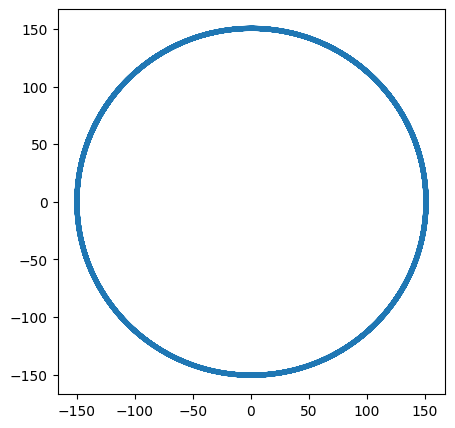

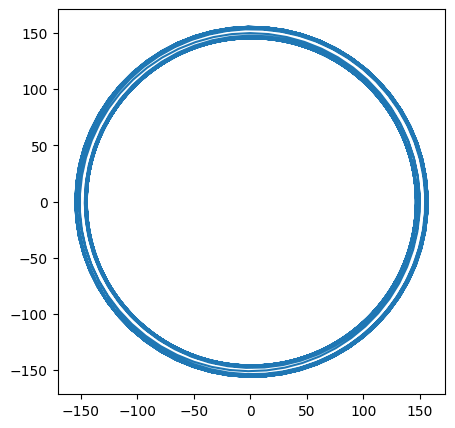

In [2]:
#plot the y-coordinate vs x-coordinate of epimetheus
fig, ax1 = plt.subplots(figsize=(5,5))  
ax1.plot(position_of_epimetheus[0], position_of_epimetheus[1])

#plot the y-coordinate vs x-coordinate of janus
fig, ax2 = plt.subplots(figsize=(5,5))  
ax2.plot(position_of_janus[0], position_of_janus[1])

From the above plot, it's clearly shown that, the Janus changed his path.

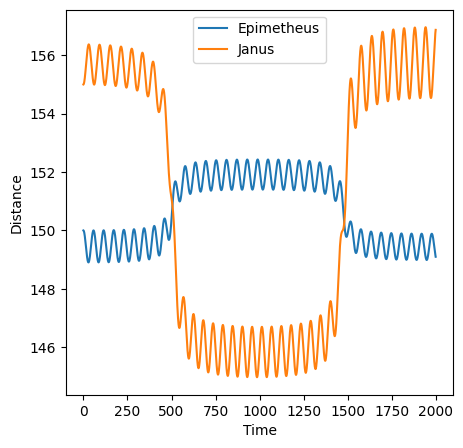

In [3]:
# plot the distance of moons from saturn as a function of time

fig, ax3 = plt.subplots(figsize=(5,5)) 
ax3.plot(t, f_dist(position_of_epimetheus,saturn_x0), label="Epimetheus")
ax3.plot(t, f_dist(position_of_janus,saturn_x0), label="Janus")
ax3.set_xlabel('Time')
ax3.set_ylabel('Distance')
ax3.legend()


From the graph above, it has been seen that, at the begining, the distance of the moons from Saturn are not same. But, it has been seen that, the distance of both moons has changed at a same time.v_epi = np.sqrt((velocity_of_epimetheus[0]**2) + (velocity_of_epimetheus[1]**2))
v_janus = np.sqrt((velocity_of_janus[0]**2) + (velocity_of_janus[1]**2))
plt.plot(t,v_epi)
plt.plot(t,v_janus) At the beginning, Janus was inside and Epimetheus was outside. But after some iteration, they change their path. Janus got closer to Saturn and Epimetheus got closer to Saturn. So from the above graph, we can say that, most of the time the moons maintain a different distance from Saturn. So there is not possible to collide with each other.

Now the question is, is it possible to collide during the change of their path, because at that moment their distance from the Saturn is same. Important fact is that, here the distance indicates the radious of their path. So, now if we find the the same position of both moons at a same time, then we can say they will collide. Let's check their positions:

In [4]:
count = 0
for j in range(len(t)):
    if position_of_epimetheus[0][j] == position_of_janus[0][j]:
        print("match x-coordinate between the moons")
    elif position_of_epimetheus[1][j] == position_of_janus[1][j]:
        print("match y-coordinate between the moons")


match y-coordinate between the moons


Here, we have not found any matched value of x coordinates between both of the moons. So no collision is happened in the full simulations. If we could have found both x and y coordinates matched, then we cross check their index, if the index will be same, then we could say that, both of the moons position found at a same place. but this is not happened here.

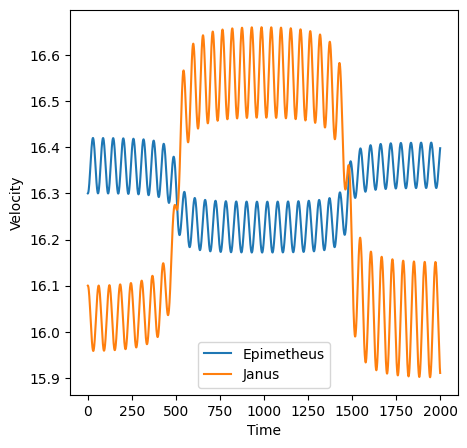

In [5]:
# velocity analysis
fig, ax4 = plt.subplots(figsize=(5,5)) 
v_epi = np.sqrt((velocity_of_epimetheus[0]**2) + (velocity_of_epimetheus[1]**2))
v_janus = np.sqrt((velocity_of_janus[0]**2) + (velocity_of_janus[1]**2))
ax4.plot(t,v_epi, label="Epimetheus")
ax4.plot(t,v_janus, label="Janus")
ax4.set_xlabel('Time')
ax4.set_ylabel('Velocity')
ax4.legend()

In [6]:
# amination

fig, ax = plt.subplots(figsize=(5,5))         
tail = 12
def update(i):                 # updatede every frame number
    ax.clear()
    ax.set_xlim(-200, 200)
    ax.set_ylim(-200, 200)

    # tail lenght of the moons
    tail = i + 12
    
    # plot the Saturn at center
    ax.scatter([0], [0], c='yellow', marker='o', 
               s = 400, label='Saturn')

    # plot the epimetheus (circle point)
    ax.plot(position_of_epimetheus[0][tail-1], position_of_epimetheus[1][tail-1], 
            marker='o', c='red', markersize=7)

    # plot the janus (circle point)
    ax.plot(position_of_janus[0][tail-1], position_of_janus[1][tail-1], 
            marker='o', c='blue', markersize=7)

    # plot the epimetheus (tail part)
    ax.plot(position_of_janus[0][i:tail],position_of_janus[1][i:tail], c='blue', 
            marker='_', markersize=1, label='Janus')

    # plot the janus (tail part)
    ax.plot(position_of_epimetheus[0][i:tail],position_of_epimetheus[1][i:tail], c='red', 
            marker='_', markersize=1, label='Epimetheus')
    
    # legends
    ax.legend(loc='upper right')
    
anim = FuncAnimation(fig, 
                     update, 
                     frames=np.arange(0,2000-tail,3), 
                     interval = 40, 
                     blit=False)

plt.close(fig)
HTML(anim.to_jshtml())